## Dependances

In [1]:
import cv2 
import argparse
import sys
import os
import json
import time
import random
import datetime
import argparse
import numpy as np
from torch.utils.data import Dataset
from PIL import Image
import matplotlib.pyplot as plt
import torch
from torch.utils.data import DataLoader

import datasets
import util.misc as utils
from models import build_model
import datasets.transforms as T
from torchvision.transforms import v2
from datasets import build_dataset
from engine import evaluate, train_one_epoch
from pathlib import Path
from torchsampler import ImbalancedDatasetSampler
from PIL import Image
from IPython.display import clear_output
import torch.nn as nn
import torch.nn.init as init

# Local dep
project_dir = '/data/konrad/workspace'
sys.path.insert(0, project_dir)

from helpers.datasets import CalfFaceDataset, CalfCenterFaceDataset
from helpers.helpers import get_indices, load_face_data, uniform_sample_with_values
from helpers.trainers import plot_metrics


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

## Utilitaires

In [2]:
class ImageDataset(Dataset):
    def __init__(self, dataset, bbox_size = 800, transform=None):
        self.dataset = dataset
        self.transform = transform
        self.bbox_size = bbox_size

    def __getitem__(self, index):
        row = self.dataset[index]
        img = row["row_image"]
        img_path = row["img_path"]
        
        if self.transform:
            img = self.transform(img)

        img = img.to(device)
        target = {}
        target["file_name"] = [str(row["img_path"])]
        target["image_label"] = torch.tensor([row["label"]], dtype=torch.int64)  # Set the target label as needed

        return img, target

    def __len__(self):
        return len(self.dataset)

    def get_labels(self):
        return self.dataset.data_frame["label"]

In [3]:
@torch.no_grad()
def predicted_class(output, topk=(1,)):
    query_logits = output['query_logits']
    batch_size = query_logits.size(0)
    
    maxk = min(max(topk), query_logits.size(1))
    _, pred = query_logits.topk(maxk, dim=1, largest=True, sorted=True)
    return pred

def get_class_name(number):
    modified_name = id2label[number]
    return modified_name

def SuperImposeHeatmap(attention, input_image):
    alpha=0.5
    avg_heatmap_resized = cv2.resize(attention, (input_image.shape[1], input_image.shape[0]), interpolation=cv2.INTER_CUBIC)
    avg_normalized_heatmap = (avg_heatmap_resized - np.min(avg_heatmap_resized)) / (np.max(avg_heatmap_resized) - np.min(avg_heatmap_resized))
    heatmap = (avg_normalized_heatmap * 255).astype(np.uint8)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    heatmap = cv2.medianBlur(heatmap,15)
    heatmap =  cv2.GaussianBlur(heatmap, (15, 15), 0)
    result = (input_image *alpha  + heatmap * (1-alpha)).astype(np.uint8)
    return result


def visualization(args, input_image, query_index, attention_scores, encoder_output):

    attention_score = attention_scores[5, :, :, :, :] # sixth layer of the decoder
    attention_score_pred_query = attention_score[:, :, query_index, :] # query corresponding to predicted class 

    # Load and resize the original image
    # input_image = cv2.imread(image_path)
    input_image = input_image.permute(1, 2, 0).numpy()
    
    np_array = input_image

    # If the values are in the range [0, 1], convert them to [0, 255]
    if np_array.max() <= 1.0:
        np_array = (np_array * 255).astype(np.uint8)

    # If the image is in the range [0, 255] but not in uint8 format, convert to uint8
    elif np_array.dtype != np.uint8:
        np_array = np_array.astype(np.uint8)

    # Convert RGB to BGR format for OpenCV
    input_image = cv2.cvtColor(np_array, cv2.COLOR_RGB2BGR)

    input_image = cv2.resize(input_image, (0, 0), fx=0.8, fy=0.8)

    # Create a subplot grid for the original image and visualizations
    num_heads = attention_score_pred_query.shape[1] + 1  
    rows = 1
    cols = num_heads // rows

    # Plot the original image
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))
    axes[0].imshow(cv2.cvtColor(input_image, cv2.COLOR_BGR2RGB))
    axes[0].axis('off')

    for head_index in range(attention_score_pred_query.shape[1]):
        heatmap_head = attention_score_pred_query[:, head_index, :].reshape(encoder_output.shape[2], encoder_output.shape[3]).detach().cpu().numpy()
        result = SuperImposeHeatmap(heatmap_head, input_image)

        if rows == 1 and cols == 1:
            ax = axes
        elif rows == 1:
            ax = axes[head_index + 1]
        elif cols == 1:
            ax = axes[head_index + 1]
        else:
            ax = axes[(head_index + 1) // cols, (head_index + 1) % cols]

        ax.imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))
        ax.axis('off')

    plt.tight_layout()
    plt.show()



def load_model(args, model):
    checkpoint = torch.load(args.resume, map_location='cpu')
    model.load_state_dict(checkpoint['model'])
    return model


In [4]:
def get_args_parser(training = False, epochs = 10, batch_size = 12):
    parser = argparse.ArgumentParser('Set transformer detector', add_help=False)
    parser.add_argument('--batch_size', default=batch_size, type=int)

    if training:
        parser.add_argument('--lr', default=5.00e-5, type=float) 
        parser.add_argument('--lr_backbone', default=0, type=float) 
        parser.add_argument('--min_lr', default=1.00e-6, type=float) 
        parser.add_argument('--weight_decay', default=1e-6, type=float)
        parser.add_argument('--epochs', default=epochs, type=int) 
        parser.add_argument('--lr_drop', default=80, type=int) 
        parser.add_argument('--lr_scheduler', default="StepLR", type=str, choices=["StepLR", "CosineAnnealingLR"])
        parser.add_argument('--clip_max_norm', default=0.1, type=float,
                            help='gradient clipping max norm')

    # * Backbone
    parser.add_argument('--backbone', default='resnet50', type=str,
                        help="Name of the convolutional backbone to use")
    parser.add_argument('--dilation', action='store_true',
                        help="If true, we replace stride with dilation in the last convolutional block (DC5)")
    parser.add_argument('--position_embedding', default='sine', type=str, choices=('sine', 'learned'),
                        help="Type of positional embedding to use on top of the image features")
    if training:
        parser.add_argument('--finetune', default='intr_checkpoint_cub_detr_r50.pth',
                        help='resume from checkpoint')
    else:
        parser.add_argument('--resume', default=ROOT_DIR + '/image_classification/repos/intr/output/calf_face/output_sub/checkpoint.pth',
                        help='resume from checkpoint')
    
    # * Transformer
    parser.add_argument('--enc_layers', default=6, type=int,
                        help="Number of encoding layers in the transformer")
    parser.add_argument('--dec_layers', default=6, type=int,
                        help="Number of decoding layers in the transformer")
    parser.add_argument('--dim_feedforward', default=2048, type=int,
                        help="Intermediate size of the feedforward layers in the transformer blocks")
    parser.add_argument('--hidden_dim', default=256, type=int,
                        help="Size of the embeddings (dimension of the transformer)")
    parser.add_argument('--dropout', default=0.1, type=float,
                        help="Dropout applied in the transformer") #default=0.1
    parser.add_argument('--nheads', default=8, type=int,
                        help="Number of attention heads inside the transformer's attentions")
    parser.add_argument('--num_queries', default=3, type=int,
                        help="Number of query slots")
    parser.add_argument('--pre_norm', action='store_true')

    # # * Dataset parameters
    parser.add_argument('--dataset_name', default='calf_face') 
    parser.add_argument('--output_dir', default='output',
                        help='path where to save, empty for no saving')
    parser.add_argument('--output_sub_dir', default='output_sub')

    # * Device parameters
    parser.add_argument('--device', default='cuda',
                        help='device to use for training / testing')
    
    return parser



def plot_metrics(train_losses, train_accuracies, train_accuracies_std, train_recalls, train_f1_scores, valid_losses, valid_accuracies, valid_recalls, valid_f1_scores):
    epochs = range(1, len(train_losses) + 1)
    
    # Plot training and validation losses
    plt.figure(figsize=(10, 5))
    plt.plot(epochs, train_losses, label='Train')
    plt.plot(epochs, valid_losses, label='Validation')
    plt.title('Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()
    
    # Plot training and validation accuracies
    plt.figure(figsize=(10, 5))
    plt.plot(epochs, train_accuracies, label='Train')
    plt.plot(epochs, train_accuracies_std, label='Train - Std')
    plt.plot(epochs, valid_accuracies, label='Validation')
    plt.title('Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.show()
    
    # Plot training and validation recalls
    plt.figure(figsize=(10, 5))
    plt.plot(epochs, train_recalls, label='Train')
    plt.plot(epochs, valid_recalls, label='Validation')
    plt.title('Recall')
    plt.xlabel('Epochs')
    plt.ylabel('Recall')
    plt.legend()
    plt.show()
    
    # Plot training and validation F1 scores
    plt.figure(figsize=(10, 5))
    plt.plot(epochs, train_f1_scores, label='Train')
    plt.plot(epochs, valid_f1_scores, label='Validation')
    plt.title('F1 Score')
    plt.xlabel('Epochs')
    plt.ylabel('F1 Score')
    plt.legend()
    plt.show()

## Setup

In [5]:
ROOT_DIR = "/data/konrad/workspace"
DATA_FILE = ROOT_DIR + '/CompleteDatasetNormalFace/Face_annotations.csv'
IMAGE_DIR = ROOT_DIR + '/CompleteDatasetNormalFace"

df, labels, label2id, id2label = load_face_data(DATA_FILE, IMAGE_DIR)

In [6]:
IMAGE_SIZE = 400
data_mean_std = {
    "cub": (
        torch.tensor([0.485, 0.456, 0.406]),
        torch.tensor([0.229, 0.224, 0.225]),
    ),
}
mean, std = data_mean_std["cub"]

train_transform = v2.Compose([
    v2.Resize(size=(IMAGE_SIZE, IMAGE_SIZE)),
    v2.RandomHorizontalFlip(p=0.5),
    # v2.ColorJitter(brightness=.5, hue=.3),
    # v2.RandomPosterize(bits=2),
    # v2.RandomEqualize(),
    # v2.AutoAugment(v2.AutoAugmentPolicy.IMAGENET),
    v2.AutoAugment(v2.AutoAugmentPolicy.CIFAR10),
    # v2.AutoAugment(v2.AutoAugmentPolicy.SVHN),
    # v2.ToDtype(torch.float32, scale=True),
    v2.Normalize(mean=mean, std=mean),
])

groupby_cols = ['target']
valid_df, train_df = uniform_sample_with_values(df, 18, groupby_cols)
train_indices, test_indices, valid_indices = get_indices(len(train_df), test_ratio=.2, valid_ratio = 0)

train_dataset = CalfCenterFaceDataset(train_df.iloc[train_indices, :].reset_index(drop=True), IMAGE_DIR)

test_transform = v2.Compose([
    v2.Resize(size=(IMAGE_SIZE, IMAGE_SIZE)),
    # v2.ToDtype(torch.float32, scale=True),
    v2.Normalize(mean=mean, std=std),
])
test_dataset = CalfCenterFaceDataset(train_df.iloc[test_indices, :].reset_index(drop=True), IMAGE_DIR, transform=None)
valid_dataset = CalfCenterFaceDataset(valid_df.reset_index(drop=True), IMAGE_DIR, transform=None)

# train_dataset = ImageDataset(train_dataset, transform=train_transform)
# test_dataset = ImageDataset(test_dataset, transform=test_transform)

# Data loaders
# batch_size = 12
# train_loader = DataLoader(train_dataset, sampler=ImbalancedDatasetSampler(train_dataset), batch_size=batch_size)
# test_loader = DataLoader(test_dataset, batch_size=batch_size * 2, shuffle=False)
# valid_dataset = ImageDataset(valid_dataset, transform=test_transform)


# dl = valid_loader.dataset.data_frame
# class_counts = dl['label'].value_counts()

# # Plot the distribution
# plt.figure(figsize=(8, 6))
# class_counts.plot(kind='bar')
# plt.title('Distribution of Classes in Validation set')
# plt.xlabel('Class')
# plt.ylabel('Count')
# plt.xticks(rotation=45)
# plt.grid(axis='y', linestyle='--', alpha=0.7)
# plt.show()

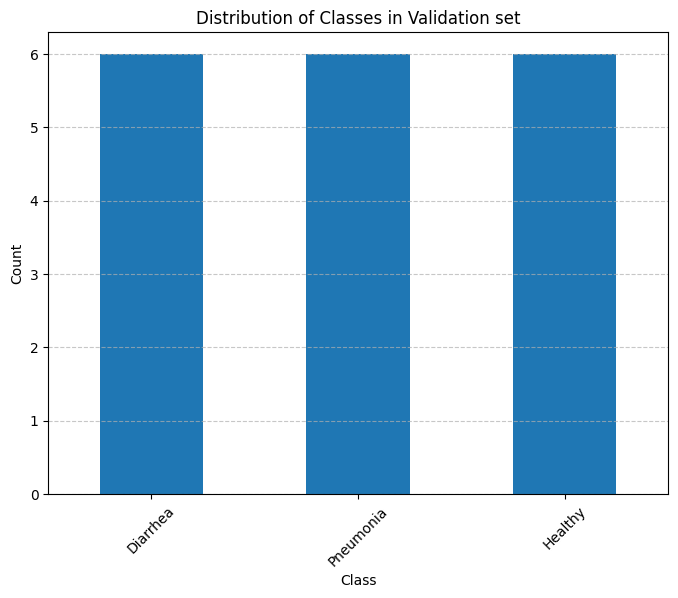

In [7]:
class_counts = valid_df['label'].value_counts()

# Plot the distribution
plt.figure(figsize=(8, 6))
class_counts.plot(kind='bar')
plt.title('Distribution of Classes in Validation set')
plt.xlabel('Class')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

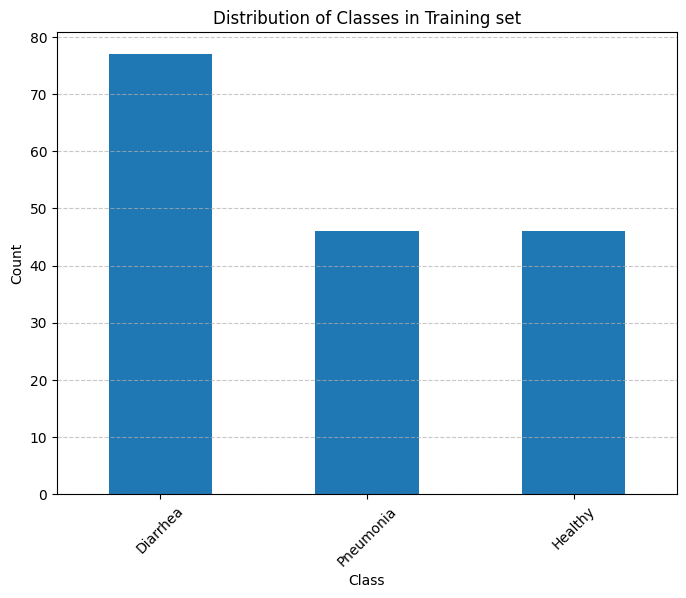

In [8]:
class_counts = train_df['label'].value_counts()

# Plot the distribution
plt.figure(figsize=(8, 6))
class_counts.plot(kind='bar')
plt.title('Distribution of Classes in Training set')
plt.xlabel('Class')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

## Training

In [9]:
args_parser = get_args_parser(training=True, epochs = 100, batch_size = 12)
parser = argparse.ArgumentParser('INTR training and evaluation script', parents=[args_parser])
args = parser.parse_args([])
if args.output_dir:
    Path(args.output_dir).mkdir(parents=True, exist_ok=True)


seed = 42
torch.manual_seed(seed)
np.random.seed(seed)
random.seed(seed)
best_valid_loss = float('inf')

model, criterion = build_model(args)
model.to(device)
model_without_ddp = model

n_parameters = sum(p.numel() for p in model.parameters() if p.requires_grad)
print('number of params:', n_parameters)

param_dicts = [
    {"params": [p for n, p in model_without_ddp.named_parameters() if "backbone" not in n and p.requires_grad]},
    {
        "params": [p for n, p in model_without_ddp.named_parameters() if "backbone" in n and p.requires_grad],
        "lr": args.lr_backbone,
    },
]


if args.lr_scheduler=="StepLR":
    optimizer = torch.optim.AdamW(param_dicts, lr=args.lr,
                                  weight_decay=args.weight_decay)
    lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, args.lr_drop)

if args.lr_scheduler=="CosineAnnealingLR":
    optimizer = torch.optim.AdamW(param_dicts, lr=args.lr, 
                                weight_decay=args.weight_decay)
    lr_scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=args.epochs, eta_min=args.min_lr)

# dataset_train = ImageDataset(train_dataset)
# dataset_val = ImageDataset(test_dataset)

dataset_train = ImageDataset(train_dataset, transform=train_transform)
dataset_val = ImageDataset(test_dataset, transform=test_transform)

sampler_train = torch.utils.data.RandomSampler(dataset_train)
sampler_val = torch.utils.data.SequentialSampler(dataset_val)

batch_sampler_train = torch.utils.data.BatchSampler(
    sampler_train, args.batch_size, drop_last=True)

data_loader_train = DataLoader(dataset_train, batch_sampler=batch_sampler_train,
                               collate_fn=utils.collate_fn)
data_loader_val = DataLoader(dataset_val, args.batch_size, sampler=sampler_val,
                             drop_last=False, collate_fn=utils.collate_fn)

#   We create output directories to store results
output_dir = Path(args.output_dir)
if not os.path.exists(os.path.join(output_dir, args.dataset_name)):
    os.makedirs(os.path.join(output_dir, args.dataset_name), exist_ok=True)
if not os.path.exists(os.path.join(output_dir, args.dataset_name, args.output_sub_dir)):
    os.makedirs(os.path.join(output_dir, args.dataset_name, args.output_sub_dir), exist_ok=True)

if args.finetune:
    if args.finetune.startswith('https'):
        checkpoint = torch.hub.load_state_dict_from_url(
            args.finetune, map_location='cpu', check_hash=True)
    else:
        checkpoint = torch.load(args.finetune, map_location='cpu')
    state_dict = checkpoint['model']

    # existing_num_queries = state_dict['query_embed.weight'].shape[0]

    # if args.num_queries<existing_num_queries:
    #     new_query_embeds = state_dict['query_embed.weight'][:args.num_queries, :]
    #     state_dict['query_embed.weight'] = new_query_embeds
    
    # model_without_ddp.load_state_dict(state_dict)

    # for param in model_without_ddp.parameters():
    #     param.requires_grad = True
    # model_without_ddp.to(device)

    existing_num_queries = state_dict['query_embed.weight'].shape[0]

    state_dict['presence_vector.weight'] = nn.init.xavier_uniform_(torch.empty(1, args.hidden_dim))
    state_dict['presence_vector.bias'] = torch.zeros(1)
    state_dict['presence_vector.bias'] = state_dict['presence_vector.bias'].resize_(1)

    if args.num_queries<existing_num_queries:
        new_query_embeds = state_dict['query_embed.weight'][:args.num_queries, :]
        state_dict['query_embed.weight'] = new_query_embeds
    
    model_without_ddp.load_state_dict(state_dict)

    for name, param in model.named_parameters():
        if "presence_vector" in name or "query_embed" in name:
            param.requires_grad = True
        else:
            param.requires_grad = False
            
    model_without_ddp.to(device)
    
train_losses, train_accuracies, train_accuracies_std, train_recalls, train_f1_scores = [], [], [], [], []
valid_losses, valid_accuracies, valid_recalls, valid_f1_scores = [], [], [], []

print("Start training")
start_time = time.time()
for epoch in range(args.epochs):

    train_stats = train_one_epoch(
        model, criterion, data_loader_train, optimizer, device, epoch,
        args.clip_max_norm)
    print("\n")

    lr_scheduler.step()

    test_stats = evaluate(
        model, criterion,  data_loader_val, device, args.output_dir
    )
    valid_loss = test_stats["loss"]
    
    if args.output_dir:
        checkpoint_paths = [output_dir / args.dataset_name / args.output_sub_dir/ 'checkpoint.pth']

        if valid_loss < best_valid_loss:
            best_valid_loss = valid_loss
            checkpoint_paths.append(output_dir / args.dataset_name / args.output_sub_dir / f'best_checkpoint.pth')

        if (epoch + 1) % args.lr_drop == 0 or (epoch + 1)==args.epochs:
            checkpoint_paths.append(output_dir / args.dataset_name / args.output_sub_dir / f'checkpoint{epoch:04}.pth')
            
        for checkpoint_path in checkpoint_paths:
            utils.save_on_master({
                'model': model_without_ddp.state_dict(),
                'optimizer': optimizer.state_dict(),
                'lr_scheduler': lr_scheduler.state_dict(),
                'epoch': epoch,
                'args': args,
            }, checkpoint_path)

    train_losses.append(train_stats["loss"])
    train_accuracies.append(train_stats["acc1"])
    train_accuracies_std.append(train_stats["acc_std"])
    train_recalls.append(train_stats["recall"])
    train_f1_scores.append(train_stats["f1"])

    valid_losses.append(test_stats["loss"])
    valid_accuracies.append(test_stats["precision"])
    valid_recalls.append(test_stats["recall"])
    valid_f1_scores.append(test_stats["f1"])

    print("-" * 30)
    print("\n\n")

total_time = time.time() - start_time
total_time_str = str(datetime.timedelta(seconds=int(total_time)))
clear_output()
print('Training time {}'.format(total_time_str))

Training time 0:11:25


## Analyse 

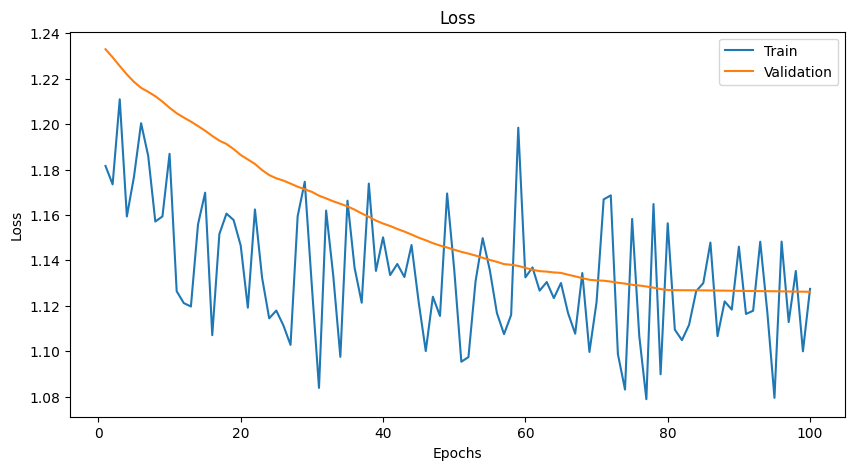

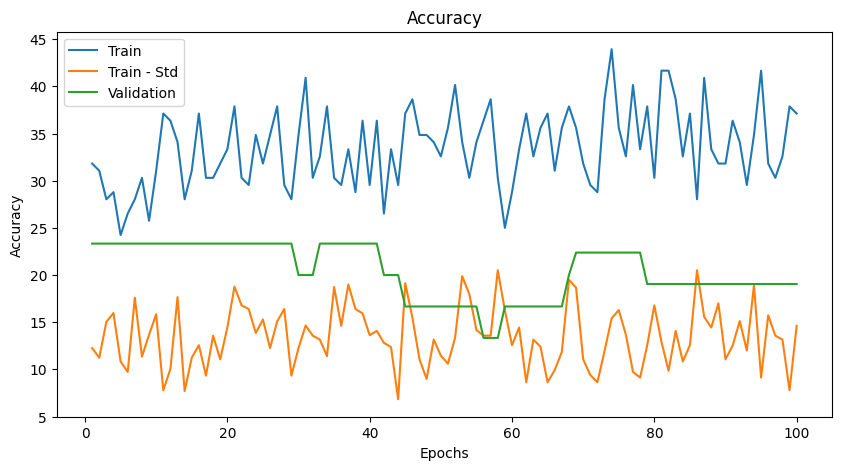

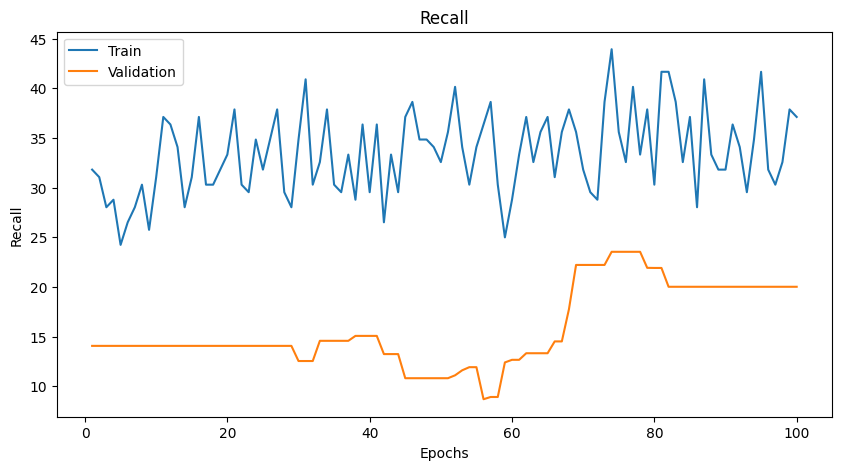

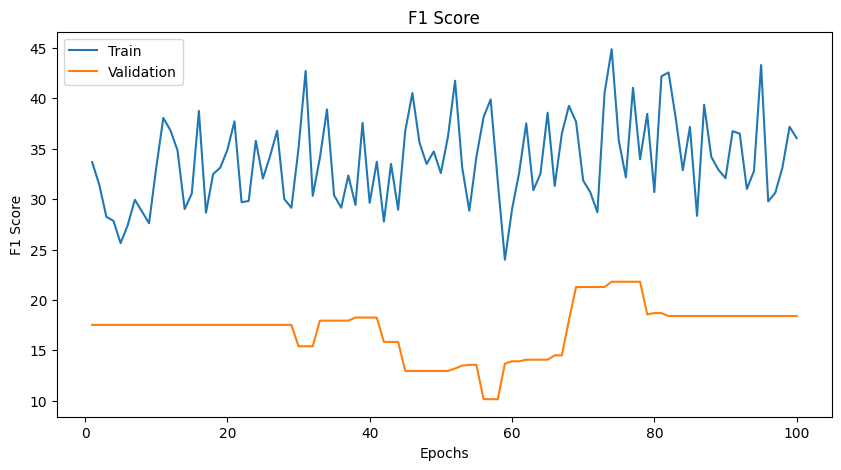

In [10]:
plot_metrics(train_losses, train_accuracies, train_accuracies_std, train_recalls, train_f1_scores,  valid_losses, valid_accuracies, valid_recalls, valid_f1_scores)

In [11]:
batch_size = 12

# Load best model saved on training
checkpoint = torch.load("output/calf_face/output_sub/best_checkpoint.pth", map_location='cpu')
model.load_state_dict(checkpoint['model'])

sampler_val = torch.utils.data.SequentialSampler(ImageDataset(valid_dataset, transform=test_transform))
valid_loader = DataLoader(dataset_val, batch_size, sampler=sampler_val, drop_last=False, collate_fn=utils.collate_fn)
test_stats = evaluate(model, criterion, valid_loader, device, args.output_dir)

Test:  [0/2]  eta: 0:00:00  loss: 1.1015 (1.1015)  time: 0.4579  data: 0.4359  max mem: 698
Test:  [1/2]  eta: 0:00:00  loss: 1.1015 (1.1209)  time: 0.3694  data: 0.3271  max mem: 698
Test: Total time: 0:00:00 (0.3704 s / it)
Stats: Accuracy 22.22222222222222, F1 21.01010101010101, Recall 18.51851851851852, Precision 24.444444444444446, 


In [12]:
# Stats: Accuracy 33.33333333333333, F1 25.071225071225072, Recall 24.444444444444446, Precision 30.555555555555554, 
# Stats: Accuracy 27.77777777777778, F1 26.38888888888889, Recall 28.53535353535353, Precision 30.833333333333336, 
# Stats: Accuracy 33.33333333333333, F1 24.33862433862434, Recall 22.22222222222222, Precision 28.14814814814815, 

Species predicted by INTR is: Pneumonia
Species class  is: Diarrhea 



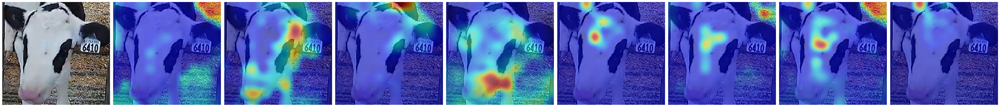

------------------------------ 

Test:  [ 0/18]  eta: 0:00:24    time: 1.3600  data: 0.0376  max mem: 698
Species predicted by INTR is: Diarrhea
Species class  is: Diarrhea 



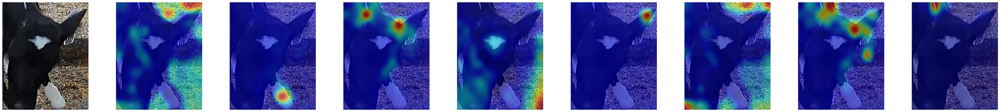

------------------------------ 

Test:  [ 1/18]  eta: 0:00:17    time: 1.0479  data: 0.0357  max mem: 698
Species predicted by INTR is: Healthy
Species class  is: Diarrhea 



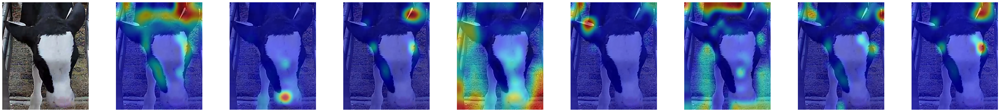

------------------------------ 

Test:  [ 2/18]  eta: 0:00:15    time: 0.9999  data: 0.0353  max mem: 698
Species predicted by INTR is: Healthy
Species class  is: Diarrhea 



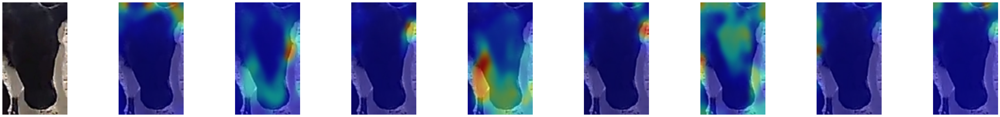

------------------------------ 

Test:  [ 3/18]  eta: 0:00:13    time: 0.8734  data: 0.0341  max mem: 698
Species predicted by INTR is: Healthy
Species class  is: Diarrhea 



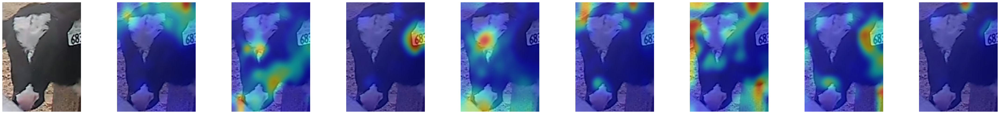

------------------------------ 

Test:  [ 4/18]  eta: 0:00:11    time: 0.8302  data: 0.0330  max mem: 698
Species predicted by INTR is: Healthy
Species class  is: Diarrhea 



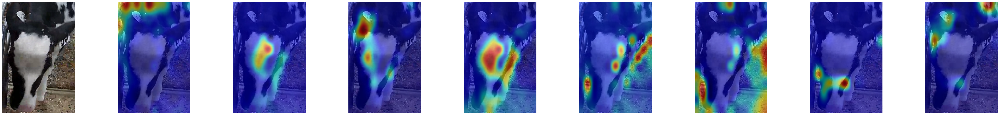

------------------------------ 

Test:  [ 5/18]  eta: 0:00:10    time: 0.8455  data: 0.0331  max mem: 698
Species predicted by INTR is: Diarrhea
Species class  is: Pneumonia 



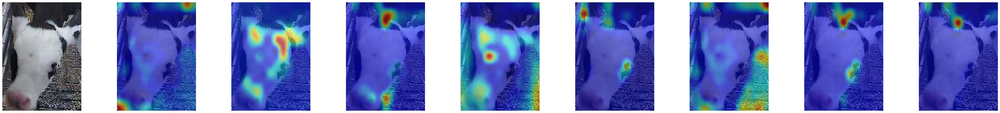

------------------------------ 

Test:  [ 6/18]  eta: 0:00:10    time: 0.9096  data: 0.0333  max mem: 698
Species predicted by INTR is: Healthy
Species class  is: Pneumonia 



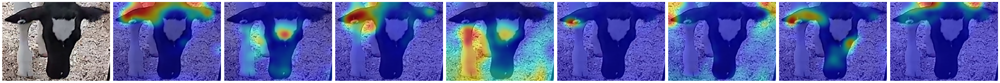

------------------------------ 

Test:  [ 7/18]  eta: 0:00:09    time: 0.8906  data: 0.0341  max mem: 698
Species predicted by INTR is: Healthy
Species class  is: Pneumonia 



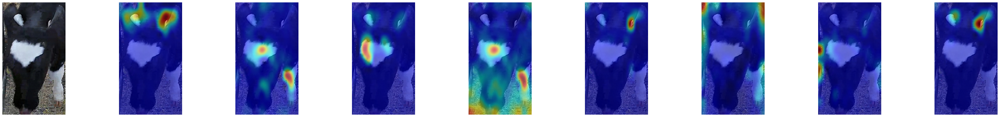

------------------------------ 

Test:  [ 8/18]  eta: 0:00:08    time: 0.8779  data: 0.0348  max mem: 698
Species predicted by INTR is: Healthy
Species class  is: Pneumonia 



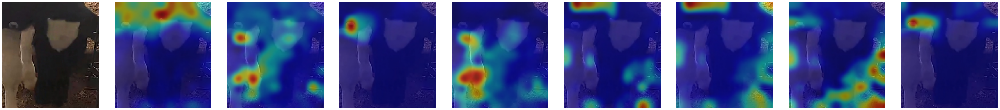

------------------------------ 

Test:  [ 9/18]  eta: 0:00:07    time: 0.8681  data: 0.0341  max mem: 698
Species predicted by INTR is: Diarrhea
Species class  is: Pneumonia 



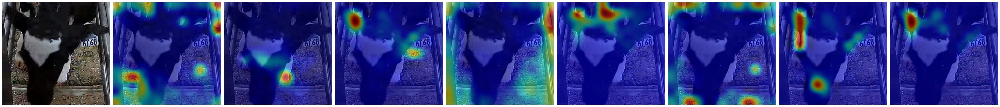

------------------------------ 

Test:  [10/18]  eta: 0:00:07    time: 0.8824  data: 0.0350  max mem: 698
Species predicted by INTR is: Healthy
Species class  is: Pneumonia 



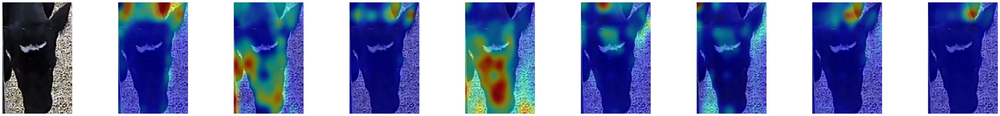

------------------------------ 

Test:  [11/18]  eta: 0:00:06    time: 0.8601  data: 0.0351  max mem: 698
Species predicted by INTR is: Diarrhea
Species class  is: Healthy 



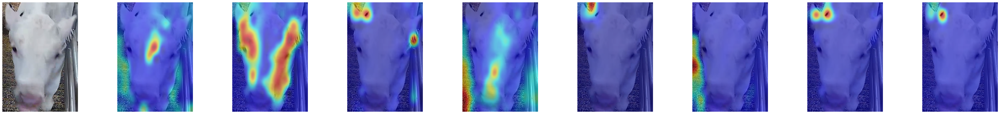

------------------------------ 

Test:  [12/18]  eta: 0:00:05    time: 0.9004  data: 0.0357  max mem: 698
Species predicted by INTR is: Healthy
Species class  is: Healthy 



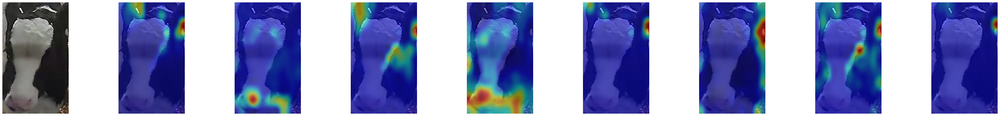

------------------------------ 

Test:  [13/18]  eta: 0:00:04    time: 0.8802  data: 0.0353  max mem: 698
Species predicted by INTR is: Diarrhea
Species class  is: Healthy 



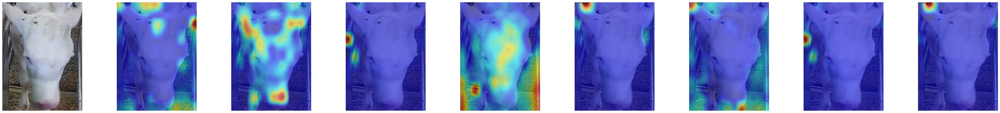

------------------------------ 

Test:  [14/18]  eta: 0:00:03    time: 0.8855  data: 0.0353  max mem: 698
Species predicted by INTR is: Pneumonia
Species class  is: Healthy 



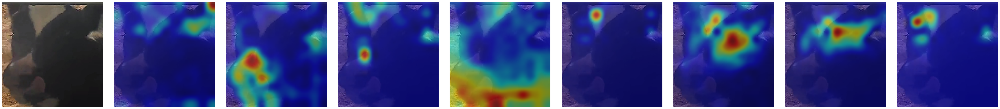

------------------------------ 

Test:  [15/18]  eta: 0:00:02    time: 0.8779  data: 0.0349  max mem: 698
Species predicted by INTR is: Pneumonia
Species class  is: Healthy 



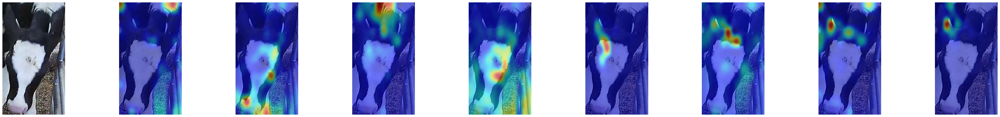

------------------------------ 

Test:  [16/18]  eta: 0:00:01    time: 0.8655  data: 0.0351  max mem: 698
Species predicted by INTR is: Healthy
Species class  is: Healthy 



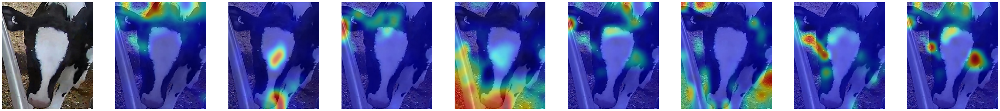

------------------------------ 

Test:  [17/18]  eta: 0:00:00    time: 0.8678  data: 0.0351  max mem: 698
Test: Total time: 0:00:15 (0.8689 s / it)


In [13]:
parser = argparse.ArgumentParser('INTR interpretation visualization script', parents=[get_args_parser()])
args = parser.parse_args(args=[])

# model, _ = build_model(args)
# model.to(device)
# model = load_model(args, model)
model.eval()

valid_dataset = ImageDataset(valid_dataset, transform=None)

valid_loader = DataLoader(valid_dataset, batch_size=1, shuffle=False)
metric_logger = utils.MetricLogger(delimiter="  ")
header = 'Test:'
for samples, targets in metric_logger.log_every(valid_loader, 1, header):
    image = samples[0].cpu()
    samples = test_transform(samples)
    samples = samples.to(device)
    image_path = targets["file_name"][0][0]
    target_class = targets["image_label"][0][0]
    
    outputs, encoder_output, _, attention_scores, avg_attention_scores = model(samples)
    pred_class_index=predicted_class(outputs, topk=(1, 1))
    print ("Species predicted by INTR is:",get_class_name(int(pred_class_index[0][0])))
    print ("Species class  is:",get_class_name(int(target_class)), "\n")

    visualization(args, image, int(pred_class_index[0][0]), attention_scores, encoder_output)
    print("-" * 30, "\n")